In [23]:
pip install squidpy

Note: you may need to restart the kernel to use updated packages.


In [24]:
import scanpy as sc
import squidpy as sq

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

## Load data - Coronal Section of a mouse brain

10x Genomics. (2020, June 23). Mouse Brain Section (Coronal) – Spatial Gene Expression dataset (Space Ranger 1.1.0) [Data set]. 10x Genomics. https://www.10xgenomics.com/datasets/mouse-brain-section-coronal-1-standard-1-1-0

The above dataset is also available readily in squidpy dataset so you do not have to download the visium data yourself!

In [25]:
adata = sq.datasets.visium_hne_adata()


In [26]:
adata

AnnData object with n_obs × n_vars = 2688 × 18078
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'leiden', 'cluster'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'cluster_colors', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [27]:
adata.X

<2688x18078 sparse matrix of type '<class 'numpy.float32'>'
	with 15411927 stored elements in Compressed Sparse Row format>

In [28]:
print(adata.X[1,3])


1.0922161


In [29]:
display(adata.obs)


,in_tissue,array_row,array_col,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,n_counts,leiden,cluster
AAACAAGTATCTCCCA-1,1,50,102,4928,8.502891,19340.0,9.869983,38.428128,43.133402,49.214064,60.449845,3857.0,8.257904,19.943123,19340.0,2,Cortex_2
AAACAATCTACTAGCA-1,1,3,43,3448,8.145840,13750.0,9.528867,50.516364,55.141818,60.952727,70.574545,3267.0,8.091933,23.760000,13750.0,11,Cortex_5
AAACACCAATAACTGC-1,1,59,19,6022,8.703341,32710.0,10.395467,40.483033,47.071232,54.564353,65.087129,4910.0,8.499233,15.010699,32710.0,7,Thalamus_2
AAACAGAGCGACTCCT-1,1,14,94,4311,8.369157,15909.0,9.674704,40.957948,45.810547,52.077440,62.976931,3270.0,8.092851,20.554403,15909.0,11,Cortex_5
AAACCGGGTAGGTACC-1,1,42,28,5787,8.663542,31856.0,10.369013,40.287544,45.887745,52.982170,64.248493,6693.0,8.808967,21.010170,31856.0,7,Thalamus_2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTGTTGTGTGTCAAGA-1,1,31,77,7016,8.856091,34390.0,10.445550,30.994475,37.758069,45.891247,57.321896,4002.0,8.294800,11.637104,34390.0,12,Lateral_ventricle
TTGTTTCACATCCAGG-1,1,58,42,6995,8.853094,44372.0,10.700386,33.284504,40.203281,48.906968,61.421617,5739.0,8.655214,12.933832,44372.0,6,Hypothalamus_1
TTGTTTCATTAGTCTA-1,1,60,30,5082,8.533657,24432.0,10.103690,38.506876,45.640963,53.675508,65.307793,3560.0,8.177796,14.571054,24432.0,6,Hypothalamus_1
TTGTTTCCATACAACT-1,1,45,27,5661,8.641532,27381.0,10.217641,36.886892,42.441839,49.589131,60.998503,5296.0,8.574896,19.341881,27381.0,7,Thalamus_2


In [30]:
adata.var

,gene_ids,feature_types,genome,mt,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts,n_cells,highly_variable,highly_variable_rank,means,variances,variances_norm
Xkr4,ENSMUSG00000051951,Gene Expression,mm10,False,233,0.093032,0.088955,91.363973,251.0,5.529429,233,False,NaN,0.093378,0.098832,0.815019
Sox17,ENSMUSG00000025902,Gene Expression,mm10,False,298,0.128243,0.120662,88.954781,346.0,5.849325,298,False,NaN,0.128720,0.156108,0.931378
Mrpl15,ENSMUSG00000033845,Gene Expression,mm10,False,1775,1.370645,0.863162,34.210526,3698.0,8.215817,1775,False,NaN,1.375744,2.163193,0.850736
Lypla1,ENSMUSG00000025903,Gene Expression,mm10,False,1294,0.741290,0.554626,52.038547,2000.0,7.601402,1293,False,NaN,0.743676,0.984143,0.873699
Tcea1,ENSMUSG00000033813,Gene Expression,mm10,False,1975,1.727947,1.003549,26.797628,4662.0,8.447414,1974,False,NaN,1.734003,3.030447,0.856292
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Tmlhe,ENSMUSG00000079834,Gene Expression,mm10,False,72,0.027798,0.027419,97.331357,75.0,4.330733,72,False,NaN,0.027902,0.029366,0.888284
Gm10931,ENSMUSG00000094350,Gene Expression,mm10,False,5,0.001853,0.001852,99.814678,5.0,1.791759,5,False,NaN,0.001860,0.001857,0.984078
AC149090.1,ENSMUSG00000095041,Gene Expression,mm10,False,2319,3.296887,1.457891,14.047443,8895.0,9.093357,2318,True,3150.0,3.308780,10.516454,1.096961
CAAA01118383.1,ENSMUSG00000063897,Gene Expression,mm10,False,695,0.320237,0.277811,74.240178,864.0,6.762730,694,False,NaN,0.321057,0.370647,0.850570


<Axes: xlabel='n_genes_by_counts', ylabel='Count'>

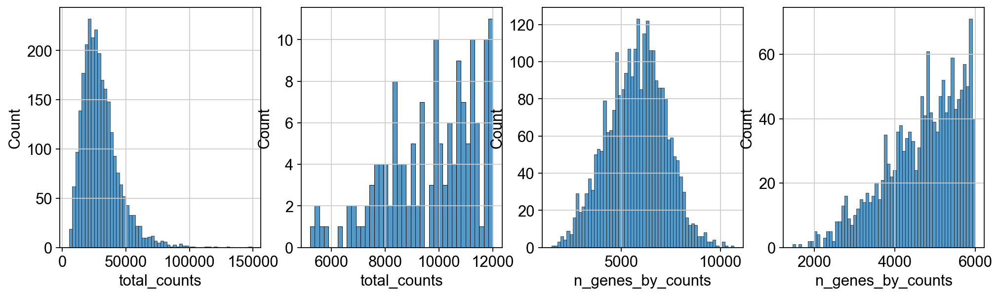

In [31]:
fig, axs = plt.subplots(1, 4, figsize=(15, 4))
sns.histplot(adata.obs["total_counts"], kde=False, ax=axs[0])
sns.histplot(adata.obs["total_counts"][adata.obs["total_counts"] < 12000], kde=False, bins=40, ax=axs[1])
sns.histplot(adata.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[2])
sns.histplot(adata.obs["n_genes_by_counts"][adata.obs["n_genes_by_counts"] < 6000], kde=False, bins=60, ax=axs[3])

In [32]:
adata

AnnData object with n_obs × n_vars = 2688 × 18078
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'leiden', 'cluster'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'cluster_colors', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

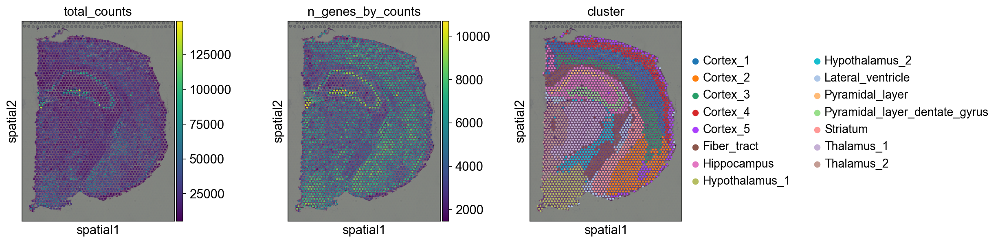

In [33]:
sc.set_figure_params(facecolor="white", figsize=(4,4))
sc.pl.spatial(adata, color=["total_counts", "n_genes_by_counts","cluster"])

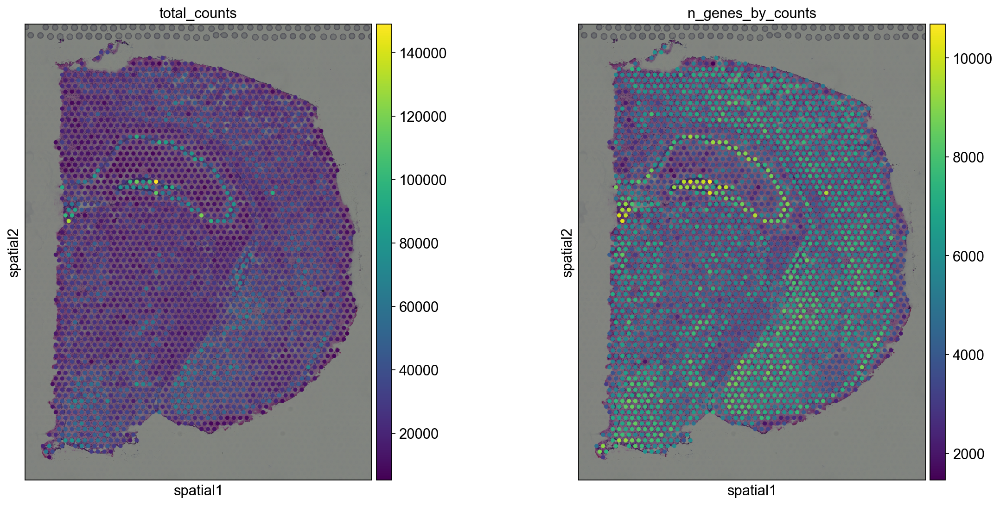

In [36]:
plt.rcParams['figure.figsize'] = (8,8)
sc.pl.spatial(adata, img_key='hires', color=['total_counts', 'n_genes_by_counts'])

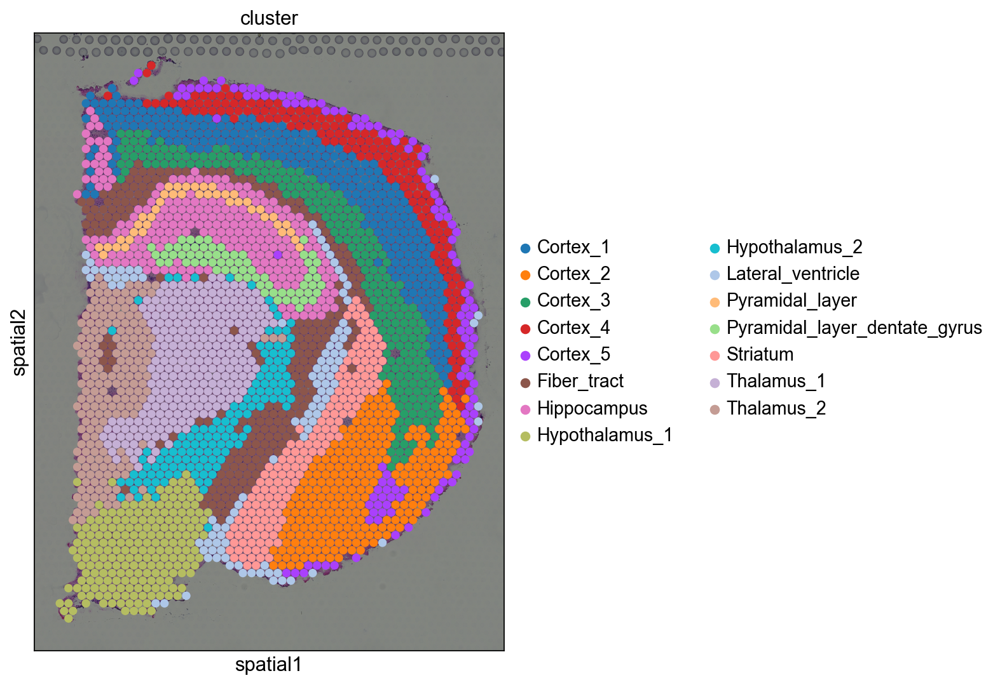

In [37]:
sc.pl.spatial(adata, color='cluster', size = 1.5)

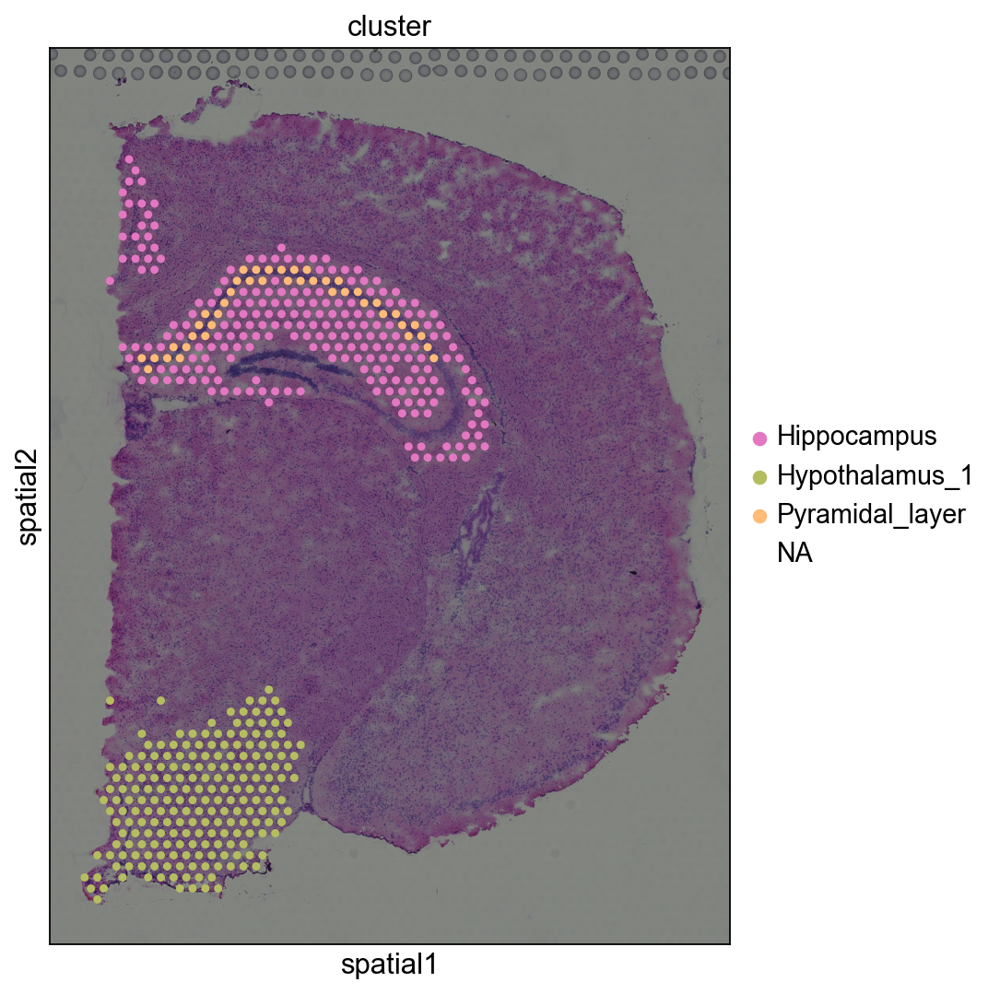

In [38]:
sc.pl.spatial(adata, color="cluster", groups=["Pyramidal_layer", "Hippocampus", "Hypothalamus_1"])


In [39]:
sq.gr.spatial_neighbors(adata)

In [40]:
sq.gr.nhood_enrichment(adata,cluster_key='cluster')

  0%|          | 0/1000 [00:00<?, ?/s]/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/geopandas/_compat.py:124: UserWarning: The Shapely GEOS version (3.11.1-CAPI-1.17.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/spatialdata/__init__.py:9: UserWarning: Geopandas was set to use PyGEOS, changing to shapely 2.0 with:

	geopandas.options.use_pygeos = True

If you intended to use PyGEOS, set the option to False.
  _check_geopandas_using_shapely()
100%|██████████| 1000/1000 [00:14<00:00, 69.51/s]


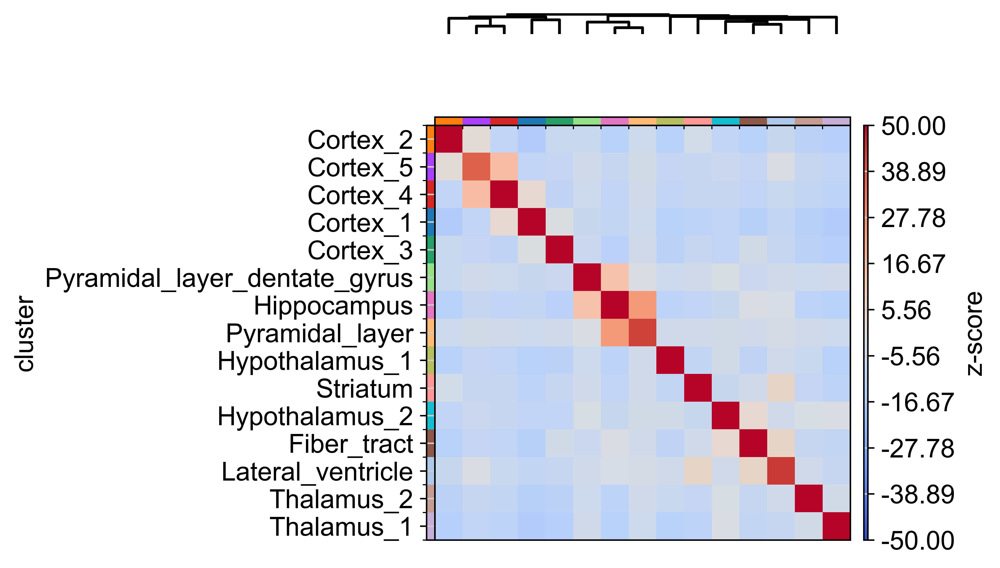

In [42]:
sq.pl.nhood_enrichment(
    adata,
    cluster_key='cluster',
    cmap='coolwarm',
    title='',
    method='ward',
    dpi=300,
    figsize=(5,4),
    cbar_kwargs={'label' : 'z-score'},
    vmin = -50,
    vmax = 50
)

- **Pyramidal_layer_dentate_gyrus** and **Pyramidal_layer** clusters seems to be often neighbors with the larger **Hippocampus** cluster. 

- Given the spatial organization of the mouse brain coronal section, not surprisingly we find high neighborhood enrichment in the Hippocampus region

  0%|          | 0/1 [00:00<?, ?/s]/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/geopandas/_compat.py:124: UserWarning: The Shapely GEOS version (3.11.1-CAPI-1.17.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/spatialdata/__init__.py:9: UserWarning: Geopandas was set to use PyGEOS, changing to shapely 2.0 with:

	geopandas.options.use_pygeos = True

If you intended to use PyGEOS, set the option to False.
  _check_geopandas_using_shapely()
100%|██████████| 1/1 [00:12<00:00, 12.54s/]


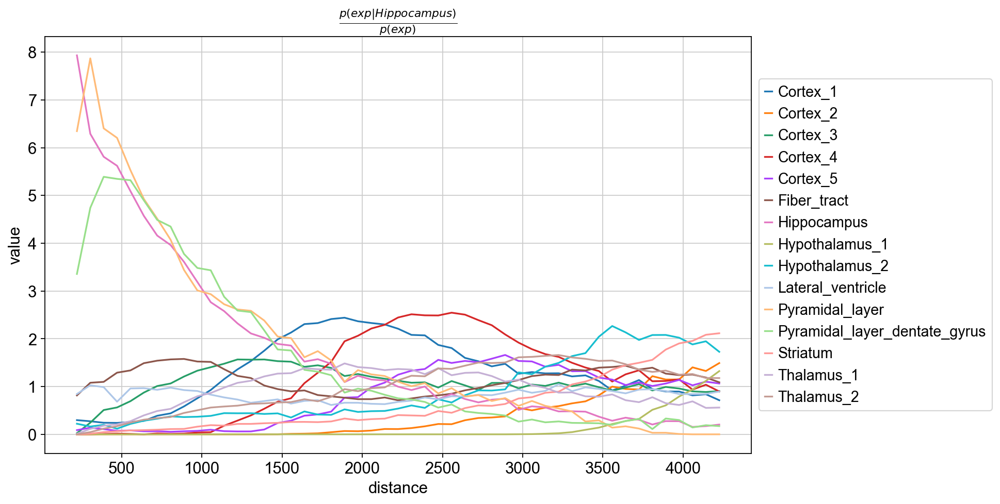

In [43]:
sq.gr.co_occurrence(adata, cluster_key='cluster')
sq.pl.co_occurrence(adata,
                    cluster_key='cluster',
                    clusters='Hippocampus',
                    figsize=(12,6)
                    )

**Pyramidal_layer** cluster seem to co-occur at short distances with the larger Hippocampus cluster.

## Ligand-receptor interaction analysis

In [44]:
res = sq.gr.ligrec(
    adata,
    n_perms = 100,
    cluster_key='cluster',
    n_jobs = 2,
    transmitter_params = {'categories' : 'ligand'},
    receiver_params = {'categories':'receptor'},
)

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
14.2MB [00:01, 9.45MB/s]
1.64MB [00:00, 5.90MB/s]
3.94MB [00:00, 7.10MB/s]
  0%|          | 0/100 [00:00<?, ?permutation/s]/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/geopandas/_compat.py:124: UserWarning: The Shapely GEOS version (3.11.1-CAPI-1.17.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/geopandas/_compat.py:124: UserWarning: The Shapely GEOS version (3.11.1-CAPI-1.17.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slo

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_baseplot_class.py:122: UserWarning: Over 500 categories found. Plot would be very large.
  warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


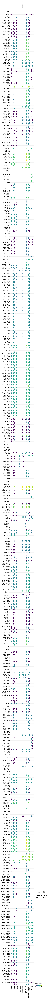

In [46]:
sq.pl.ligrec(adata, 
             cluster_key="cluster",
             source_groups="Hippocampus", 
             #target_groups=["Pyramidal_layer_dentate_gyrus", "Pyramidal_layer"],
             means_range=(3, np.inf),
             alpha=0.005,
             swap_axes=False,)

## Ripley's L Function

- The Ripley’s L function is a statistic measure used to determine whether points have a random, dispersed or clustered distribution pattern at certain scale. The Ripley’s L is a variance-normalized version of the Ripley’s K statistic.

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/squidpy/pl/_graph.py:317: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(y="stats", x="bins", ci="sd", alpha=0.01, color="gray", data=res["sims_stat"], ax=ax)


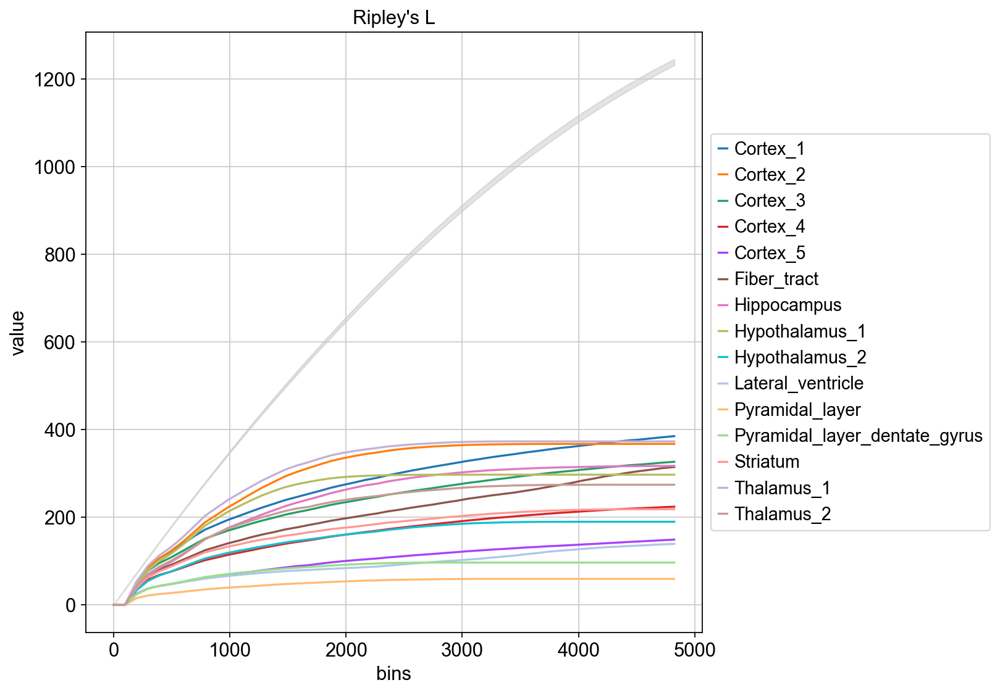

In [48]:
mode = 'L'
sq.gr.ripley(adata, cluster_key='cluster', mode=mode)

sq.pl.ripley(adata, cluster_key='cluster', mode=mode)

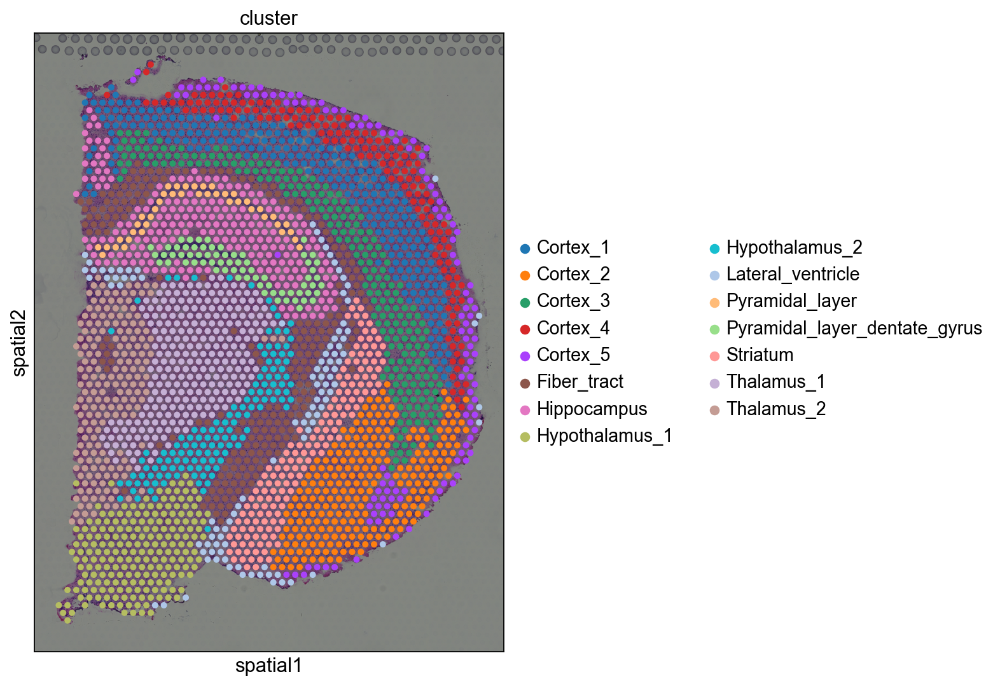

In [49]:
sc.pl.spatial(adata, color= 'cluster', spot_size=100)

## Calculating Moran's I score

- evaluates whether features (i.e. genes) shows a pattern that is clustered, dispersed or random in the tissue are under consideration.

In [51]:
genes = adata[:, adata.var.highly_variable].var_names.values[:100]

sq.gr.spatial_neighbors(adata)
sq.gr.spatial_autocorr(
    adata,
    mode="moran",
    genes=genes,
    n_perms=100,
    n_jobs=1,
)
adata.uns["moranI"].head(10)

  0%|          | 0/100 [00:00<?, ?/s]/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/geopandas/_compat.py:124: UserWarning: The Shapely GEOS version (3.11.1-CAPI-1.17.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/spatialdata/__init__.py:9: UserWarning: Geopandas was set to use PyGEOS, changing to shapely 2.0 with:

	geopandas.options.use_pygeos = True

If you intended to use PyGEOS, set the option to False.
  _check_geopandas_using_shapely()
100%|██████████| 100/100 [00:14<00:00,  6.77/s]


,I,pval_norm,var_norm,pval_z_sim,pval_sim,var_sim,pval_norm_fdr_bh,pval_z_sim_fdr_bh,pval_sim_fdr_bh
3110035E14Rik,0.665132,0.0,0.000131,0.0,0.009901,0.000233,0.0,0.0,0.012074
Resp18,0.649582,0.0,0.000131,0.0,0.009901,0.000278,0.0,0.0,0.012074
1500015O10Rik,0.605940,0.0,0.000131,0.0,0.009901,0.000197,0.0,0.0,0.012074
Ecel1,0.570304,0.0,0.000131,0.0,0.009901,0.000245,0.0,0.0,0.012074
2010300C02Rik,0.539469,0.0,0.000131,0.0,0.009901,0.000205,0.0,0.0,0.012074
Scg2,0.476060,0.0,0.000131,0.0,0.009901,0.000215,0.0,0.0,0.012074
Ogfrl1,0.457945,0.0,0.000131,0.0,0.009901,0.000162,0.0,0.0,0.012074
Itm2c,0.451842,0.0,0.000131,0.0,0.009901,0.000188,0.0,0.0,0.012074
Tuba4a,0.451810,0.0,0.000131,0.0,0.009901,0.000163,0.0,0.0,0.012074
Satb2,0.429162,0.0,0.000131,0.0,0.009901,0.000221,0.0,0.0,0.012074


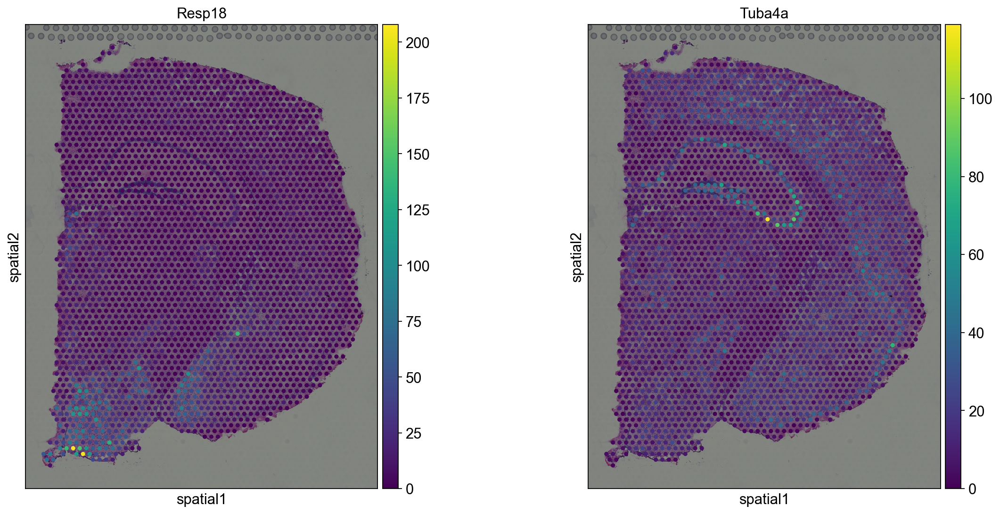

In [52]:
sc.pl.spatial(adata, color=["Resp18", "Tuba4a"])


## Calculating the sepal score (Transcriptomics)

In [53]:
sq.gr.spatial_neighbors(adata)

genes = adata.var_names[(adata.var.n_cells > 100) & adata.var.highly_variable][0:100]
sq.gr.sepal(adata, max_neighs=6, genes=genes, n_jobs=1)
adata.uns["sepal_score"].head(10)

  0%|          | 0/100 [00:00<?, ?/s]/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/geopandas/_compat.py:124: UserWarning: The Shapely GEOS version (3.11.1-CAPI-1.17.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/spatialdata/__init__.py:9: UserWarning: Geopandas was set to use PyGEOS, changing to shapely 2.0 with:

	geopandas.options.use_pygeos = True

If you intended to use PyGEOS, set the option to False.
  _check_geopandas_using_shapely()
100%|██████████| 100/100 [00:54<00:00,  1.83/s]


,sepal_score
Lct,7.868
1500015O10Rik,7.085
Ecel1,5.274
Fzd5,4.694
Cfap65,4.095
C1ql2,3.144
Slc9a2,2.947
Gm17634,2.904
St18,2.568
Des,2.494


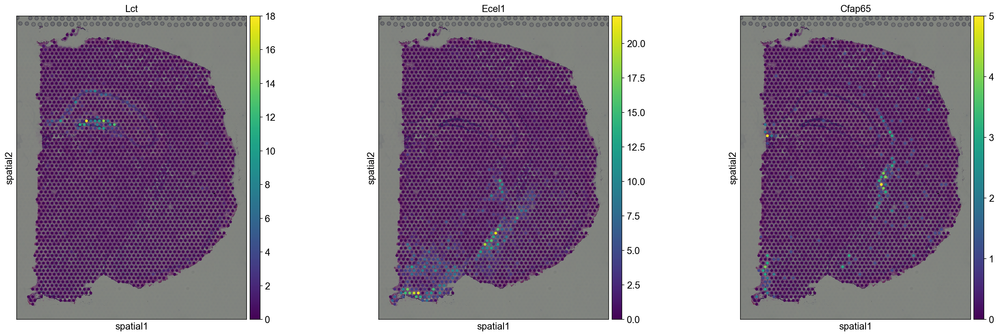

In [54]:
sc.pl.spatial(adata, color=["Lct", "Ecel1", "Cfap65"])
